# **Public Transport Accessibility to Business Locations such as Bars/Taverns/Pubs**

**Authored by**: Thakoor Madhuvaishali

**Level:** Intermediate

**Pre-requisite Skills:** Python, Data analysis, Data cleaning, Data visualization

Scenario:

As a business owner or city planner, I want to understand the relationship between business locations (such as bars, taverns, and pubs) and public transport accessibility, so that I can make informed decisions about where to establish new businesses or how to improve public transport infrastructure to support existing businesses. By analyzing this relationship, I can identify areas where better transport options could enhance business patronage and growth, ultimately contributing to the economic development of Melbourne.

What this use case will teach you

At the end of this use case, you will:

* Learn how to use Python to analyze and visualize data, enabling you to extract meaningful insights from datasets related to business locations and public transport.
* Gain experience in mapping and geocoding, allowing you to plot business establishment locations on a map and determine their proximity to public transport options.
* Understand how to integrate multiple datasets for analysis, helping you combine information about business locations, bus stops, and tram stops to create a comprehensive and user-friendly tool for analyzing public transport accessibility to business locations.


Introduction:


Public transport accessibility is a crucial factor that can influence the success and growth of businesses. For bars, taverns, and pubs, easy access to public transport can significantly impact customer patronage, especially for those who prefer not to drive. This use case aims to explore the relationship between business locations and public transport accessibility in Melbourne by integrating and analyzing data from the City of Melbourne's Census of Land Use and Employment (CLUE) dataset (2002-2022) along with Bus Stops and Tram Stops datasets. By overlaying business establishment locations with bus and tram stops, this analysis aims to understand how accessibility to these public transport modes impacts business patronage and growth.


**DATASETS LIST:**

*  Bar, tavern, pub patron capacity

https://data.melbourne.vic.gov.au/explore/dataset/bars-and-pubs-with-patron-capacity/information/

This dataset contains information about the locations and industry classifications of business establishments in Melbourne, covering the period from 2002 to 2022. It includes details such as the name, address, and classification (e.g., bars, taverns, pubs) of each business.

* Bus stops

https://data.melbourne.vic.gov.au/explore/dataset/bus-stops/

This dataset contains information about the locations of bus stops in the area, including their geographic coordinates (latitude and longitude). This information is crucial for helping users navigate to their desired support service locations using public transport.

* Tram tracks

https://data.melbourne.vic.gov.au/explore/dataset/tram-tracks/

This dataset contains information about the tram tracks in the area, including their routes and stops. Tram tracks are another important aspect of public transport infrastructure that can help users plan their journeys to support service locations.

# **Importing modules and fetching data from Open Data Melbourne**

In [ ]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import HeatMap

# Function that extracts the data from the JSON
def get_data(base, data_url, offset = 0):

    filters = f'records?limit={100}&offset={offset}&timezone=UTC'
    url = f'{base}{data_url}/{filters}'
    result = requests.get(url)
    # if you need to extract more than 9900 records, enter the api key like below
    #result = requests.get(url + f'&apikey={API_KEY}')
    result_json = result.json()
    max_results = result_json['total_count']
    links = result_json['links']
    records = result_json['records']
    records_df = pd.json_normalize(records)

    # fix columns names
    records_df.drop(columns=['links'],inplace=True)
    column_names = records_df.columns.values.tolist()

    column_names = [i.split('.')[-1] for i in column_names]
    records_df.columns = column_names

    next_url = None

    # get next url
    if records_df.shape[0] != max_results:
        for l in links:
            if l['rel']=='next':
                next_url = l['href']

    return [records_df, next_url, column_names]

In [ ]:
# Appends each set of data
def add_to_dataframe(dataframe, new_data):
    df = pd.concat([dataframe, new_data])
    return df

In [ ]:
# Extracts the data from the url to produce a pandas dataset
def extract_dataframe(dataset):
    df_new, url_next, column_names = get_data(base_url, dataset)
    df = pd.DataFrame(columns=column_names)
    while url_next != None:
        df_new, url_next, column_names = get_data(base_url, dataset, df.shape[0])
        df = add_to_dataframe(df, df_new)
        # This limits the dataset to only 9900 entries, should be removed if you want to import more data
        # To get more than 9900, enter the API key in the get data function
        if df.shape[0] == 9900:
            break
    return df

In [ ]:
# Base url for v2 api
base_url = 'https://data.melbourne.vic.gov.au/api/explore/v2.0/catalog/datasets/'

# A filter at the end of the url
number_of_records = 100
filters = f'records?limit={number_of_records}&offset=0&timezone=UTC'

# The generated url
# dataset_url = f'{base_url}{dataset}/{filters}'

In [ ]:
# Creating a dataframe for the bar tavern and pub dataset
df = extract_dataframe("bars-and-pubs-with-patron-capacity")
#extracting data for the bus stops and tram tracks and creating the dataframes
df_bus_stop = extract_dataframe("bus-stops")
df_tram_tracks = extract_dataframe("tram-tracks")

<ipython-input-2-7ac80757e1c9>:3: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([dataframe, new_data])
<ipython-input-2-7ac80757e1c9>:3: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([dataframe, new_data])
<ipython-input-2-7ac80757e1c9>:3: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old beha

# **Exploratory Analysis**

The section involves the initial steps taken to understand and prepare the dataset for analysis. I have firstly explored the bar,patron, pub dataset and then proceeded to explore the bus stop and tram tracks dataset which were very similarly structured. The df.head() command displays a snapshot of the dataset's first few rows, providing an overview of its structure and the type of information it contains. This step helps in understanding the dataset's format and identifying any potential issues or inconsistencies. The df.info() command provides a summary of the dataset, including the number of entries and columns, as well as the data types of each column. This summary helps in assessing the dataset's overall quality and identifying any missing or incorrect data. Finally, cleaning null values from the lat and lon columns ensures that the dataset is ready for further analysis, as missing location information could impact the accuracy of geographical analysis or mapping visualizations.

In [ ]:
df.head(5)

,id,timestamp,size,census_year,block_id,property_id,base_property_id,building_address,clue_small_area,trading_name,business_address,number_of_patrons,longitude,latitude,lon,lat,location
0,fe74fb3491a0b9d14784197d08fbbc1400c32685,2023-09-06T03:17:19.259Z,251,2002,11,108972,108972,10-22 Spencer Street MELBOURNE 3000,Melbourne (CBD),Explorers Inn,10-22 Spencer Street MELBOURNE 3000,50,144.955254,-37.820511,144.955254,-37.820511,NaN
1,9cba302a22bac92ec3bede0311980050960cd01b,2023-09-06T03:17:19.259Z,251,2002,14,103172,103172,31-39 Elizabeth Street MELBOURNE 3000,Melbourne (CBD),Connells Tavern,35 Elizabeth Street MELBOURNE 3000,350,144.964322,-37.817426,144.964322,-37.817426,NaN
2,28f468ec58efecb707d5cdf673b3b4e24c5e58d3,2023-09-06T03:17:19.259Z,258,2002,15,103944,103944,277-279 Flinders Lane MELBOURNE 3000,Melbourne (CBD),De Biers,"Unit 1, Basement , 277 Flinders Lane MELBOURNE...",400,144.965307,-37.817242,144.965307,-37.817242,NaN
3,c7df95c9e61ded1abe89b83bb0dfcff20e209c6b,2023-09-06T03:17:19.259Z,243,2002,16,103938,103938,187 Flinders Lane MELBOURNE 3000,Melbourne (CBD),Adelphi Hotel,187 Flinders Lane MELBOURNE 3000,80,144.968385,-37.816360,144.968385,-37.816360,NaN
4,0e6806dc0d1e38e1dad5a651015d4725fa6e869d,2023-09-06T03:17:19.259Z,265,2002,17,103925,103925,121-123 Flinders Lane MELBOURNE 3000,Melbourne (CBD),Velour,"Unit 1, Gnd & Bmt , 121 Flinders Lane MELBOURN...",350,144.970523,-37.815674,144.970523,-37.815674,NaN


In [ ]:
df.info() # this will give us the number of rows and columns in the dataset for the bars,pubs and traverns

<class 'pandas.core.frame.DataFrame'>
Index: 4696 entries, 0 to 95
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 4696 non-null   object 
 1   timestamp          4696 non-null   object 
 2   size               4696 non-null   object 
 3   census_year        4696 non-null   object 
 4   block_id           4696 non-null   object 
 5   property_id        4696 non-null   object 
 6   base_property_id   4696 non-null   object 
 7   building_address   4696 non-null   object 
 8   clue_small_area    4696 non-null   object 
 9   trading_name       4696 non-null   object 
 10  business_address   4696 non-null   object 
 11  number_of_patrons  4696 non-null   object 
 12  longitude          4676 non-null   float64
 13  latitude           4676 non-null   float64
 14  lon                4676 non-null   float64
 15  lat                4676 non-null   float64
 16  location           0 non-null  

In [ ]:
# Drop the 'location' column
df = df.drop(columns=['location'])

In [ ]:
df.head(5) # overview of the cleaned dataset

,id,timestamp,size,census_year,block_id,property_id,base_property_id,building_address,clue_small_area,trading_name,business_address,number_of_patrons,longitude,latitude,lon,lat
0,fe74fb3491a0b9d14784197d08fbbc1400c32685,2023-09-06T03:17:19.259Z,251,2002,11,108972,108972,10-22 Spencer Street MELBOURNE 3000,Melbourne (CBD),Explorers Inn,10-22 Spencer Street MELBOURNE 3000,50,144.955254,-37.820511,144.955254,-37.820511
1,9cba302a22bac92ec3bede0311980050960cd01b,2023-09-06T03:17:19.259Z,251,2002,14,103172,103172,31-39 Elizabeth Street MELBOURNE 3000,Melbourne (CBD),Connells Tavern,35 Elizabeth Street MELBOURNE 3000,350,144.964322,-37.817426,144.964322,-37.817426
2,28f468ec58efecb707d5cdf673b3b4e24c5e58d3,2023-09-06T03:17:19.259Z,258,2002,15,103944,103944,277-279 Flinders Lane MELBOURNE 3000,Melbourne (CBD),De Biers,"Unit 1, Basement , 277 Flinders Lane MELBOURNE...",400,144.965307,-37.817242,144.965307,-37.817242
3,c7df95c9e61ded1abe89b83bb0dfcff20e209c6b,2023-09-06T03:17:19.259Z,243,2002,16,103938,103938,187 Flinders Lane MELBOURNE 3000,Melbourne (CBD),Adelphi Hotel,187 Flinders Lane MELBOURNE 3000,80,144.968385,-37.816360,144.968385,-37.816360
4,0e6806dc0d1e38e1dad5a651015d4725fa6e869d,2023-09-06T03:17:19.259Z,265,2002,17,103925,103925,121-123 Flinders Lane MELBOURNE 3000,Melbourne (CBD),Velour,"Unit 1, Gnd & Bmt , 121 Flinders Lane MELBOURN...",350,144.970523,-37.815674,144.970523,-37.815674


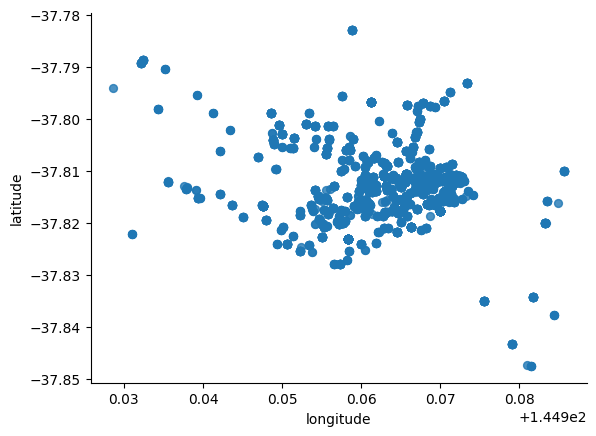

In [ ]:

from matplotlib import pyplot as plt
df.plot(kind='scatter', x='longitude', y='latitude', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
#cleaning the datasets of missing values for latitude,longitude and name as these would be the crucial components for analysis
df = df.dropna(subset=['latitude', 'longitude', 'trading_name'])

In [ ]:
map = folium.Map(location=[-37.8136, 144.9631], zoom_start=12)  # Melbourne coordinates
for index, row in df.iterrows():
    folium.Marker([row['latitude'], row['longitude']], popup=row['trading_name']).add_to(map)


In [ ]:
map

In [ ]:
df_bus_stop.head(5)

,id,timestamp,size,lon,lat,type,coordinates,type,prop_id,addresspt1,...,asset_type,objectid,str_id,addresspt,asset_subt,model_desc,mcc_id,roadseg_id,descriptio,model_no
0,8a7367eeeb000301c668152ba5dba9ff25ad3a1c,2022-11-13T10:04:50.153Z,282,144.968896,-37.818425,Feature,"[144.96889648633675, -37.81842481335676]",Point,573333,29.149053,...,Sign - Public Transport,749,1249454,606816,None,Sign - Public Transport 1 Panel,1249454,0,Sign - Public Transport 1 Panel Bus Stop Type 12,P.16
1,8d32170acd436dc5d240120e04aa0b394dbbe762,2022-11-13T10:04:50.153Z,282,144.958882,-37.817676,Feature,"[144.95888238475013, -37.81767597164006]",Point,0,10.537902,...,Sign - Public Transport,2098,1247042,507646,None,Sign - Public Transport 1 Panel,1247042,20118,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16
2,a28d5d448682f46db10d2e29c83adae14c26f2db,2022-11-13T10:04:50.153Z,281,144.959632,-37.781889,Feature,"[144.95963193312105, -37.78188915501449]",Point,0,25.269643,...,Sign - Public Transport,2143,1252383,108510,None,Sign - Public Transport 1 Panel,1252383,22387,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16
3,5ece9979014dc6b130ba352fbf03046d6741aff1,2022-11-13T10:04:50.153Z,281,144.947167,-37.793727,Feature,"[144.94716743007305, -37.793726533289785]",Point,0,44.230506,...,Sign - Public Transport,2627,1249788,100087,None,Sign - Public Transport 1 Panel,1249788,20919,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16
4,85ffb2cb3cbbd99440315bab55910949c3572d91,2022-11-13T10:04:50.153Z,282,144.927785,-37.802862,Feature,"[144.92778487963457, -37.80286165064241]",Point,0,67.718553,...,Sign - Public Transport,3306,1235311,103002,None,Sign - Public Transport 1 Panel,1235311,21680,Sign - Public Transport 1 Panel Bus Stop Type 13,P.16


In [ ]:
df_bus_stop.info()

<class 'pandas.core.frame.DataFrame'>
Index: 309 entries, 0 to 8
Data columns (total 22 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           309 non-null    object 
 1   timestamp    309 non-null    object 
 2   size         309 non-null    object 
 3   lon          309 non-null    float64
 4   lat          309 non-null    float64
 5   type         309 non-null    object 
 6   coordinates  309 non-null    object 
 7   type         309 non-null    object 
 8   prop_id      309 non-null    object 
 9   addresspt1   309 non-null    float64
 10  addressp_1   309 non-null    object 
 11  asset_clas   309 non-null    object 
 12  asset_type   309 non-null    object 
 13  objectid     309 non-null    object 
 14  str_id       309 non-null    object 
 15  addresspt    309 non-null    object 
 16  asset_subt   0 non-null      object 
 17  model_desc   309 non-null    object 
 18  mcc_id       309 non-null    object 
 19  roadseg_id   30

In [ ]:
df_tram_tracks.head(5) #overview of the tram tracks dataset

,id,timestamp,size,lon,lat,type,coordinates,type,descriptio,name
0,6367ab838d06963b6a3aa4d22b23651502923987,2022-11-13T10:05:52.941Z,649,144.955678,-37.810155,Feature,"[[[[144.955454056839, -37.8097457246493], [144...",MultiPolygon,<center><table><tr><th colspan='2' align='cent...,kml_13
1,fe09603240fd2860951e1468796ca65c9962cbd4,2022-11-13T10:05:52.941Z,722,144.959455,-37.815324,Feature,"[[[[144.958358092682, -37.8156091337363], [144...",MultiPolygon,<center><table><tr><th colspan='2' align='cent...,kml_14
2,53af8dc57bca9d173e8130cf5db164187d80e175,2022-11-13T10:05:52.941Z,2081,144.956783,-37.801184,Feature,"[[[[144.956816503317, -37.8011090399539], [144...",MultiPolygon,<center><table><tr><th colspan='2' align='cent...,kml_19
3,8a1aeb1791890a2de5d5e98dbca5b6c794c3ebee,2022-11-13T10:05:52.941Z,500,144.965494,-37.813569,Feature,"[[[[144.965484540487, -37.8136038043156], [144...",MultiPolygon,<center><table><tr><th colspan='2' align='cent...,kml_21
4,edb805bfa53a27b57bb087bce5d170bd7015a124,2022-11-13T10:05:52.941Z,3438,144.940489,-37.787818,Feature,"[[[[144.940458640488, -37.7877501106288], [144...",MultiPolygon,<center><table><tr><th colspan='2' align='cent...,kml_25


In [ ]:
df_tram_tracks.info()

<class 'pandas.core.frame.DataFrame'>
Index: 645 entries, 0 to 44
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           645 non-null    object 
 1   timestamp    645 non-null    object 
 2   size         645 non-null    object 
 3   lon          645 non-null    float64
 4   lat          645 non-null    float64
 5   type         645 non-null    object 
 6   coordinates  645 non-null    object 
 7   type         645 non-null    object 
 8   descriptio   645 non-null    object 
 9   name         645 non-null    object 
dtypes: float64(2), object(8)
memory usage: 71.6+ KB


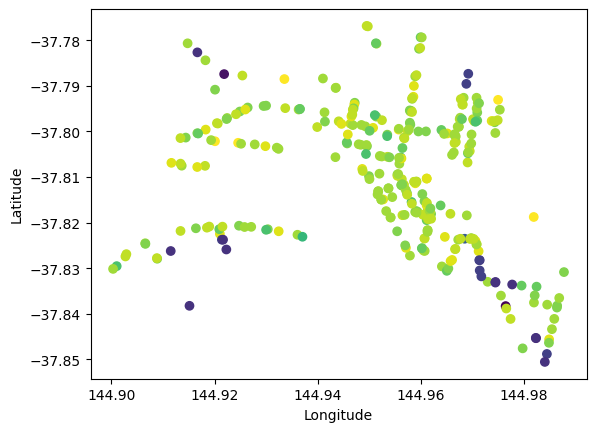

In [ ]:
# Plotting the bus stop locations

import matplotlib.pyplot as plt
plt.scatter(df_bus_stop['lon'], df_bus_stop['lat'], c=df_bus_stop['size'])
plt.xlabel('Longitude')
_ = plt.ylabel('Latitude')

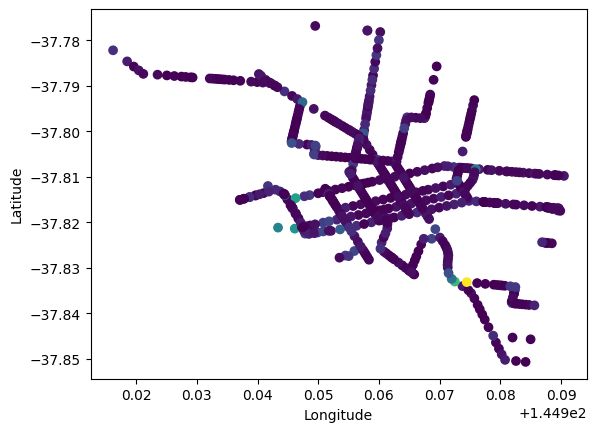

In [ ]:
#Plotting the tram track locations

import matplotlib.pyplot as plt
plt.scatter(df_tram_tracks['lon'], df_tram_tracks['lat'], c=df_tram_tracks['size'])
plt.xlabel('Longitude')
_ = plt.ylabel('Latitude')

In [ ]:
# Add tram stop markers to the map
for index, row in df_tram_tracks.iterrows():
    folium.Marker([row['lat'], row['lon']], icon=folium.Icon(color='green'), popup=row['name']).add_to(map)

# Add bus stop markers to the map
for index, row in df_bus_stop.iterrows():
    folium.Marker([row['lat'], row['lon']], icon=folium.Icon(color='red'), popup=row['descriptio']).add_to(map)

In [ ]:
map

The visualisation of this map integrates all available datasets, including the bars, cafes and oubs dataset, bus stops, and tram tracks, to create a comprehensive map showcasing the spatial distribution of these elements. By combining these datasets into a single map, the analysis provides an overview of the entire transportation and support service landscape in the area of interest.



# **Finding the nearest public transport to the business locations**

In this section, we are finding the nearest bus stop and tram stop to the support services.  The map draws paths from services to their nearest stops, providing a visual connection for accessibility.


In [ ]:
from math import radians, sin, cos, sqrt, atan2


# Function to calculate distance between two points
def haversine_distance(lat1, lon1, lat2, lon2):
    # Convert latitude and longitude from degrees to radians
    lat1, lon1, lat2, lon2 = radians(lat1), radians(lon1), radians(lat2), radians(lon2)

    # Haversine formula
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat / 2) ** 2 + cos(lat1) * cos(lat2) * sin(dlon / 2) ** 2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))
    r = 6371  # Radius of Earth in kilometers
    distance = r * c

    return distance

# Iterate over each business service and calculate the distance to the nearest bus stop
for index, service_row in df.iterrows():
    nearest_distance = float('inf')  # Initialize with a large value
    for stop_index, stop_row in df_bus_stop.iterrows():
        distance = haversine_distance(service_row['lat'], service_row['lon'],
                                       stop_row['lat'], stop_row['lon'])
        if distance < nearest_distance:
            nearest_distance = distance
    # Update the support service DataFrame with the nearest distance to a bus stop
    df.at[index, 'nearest_bus_stop_distance'] = nearest_distance

# Iterate over each business service and calculate the distance to the nearest tram stop
for index, service_row in df.iterrows():
    nearest_distance = float('inf')  # Initialize with a large value
    for stop_index, stop_row in df_tram_tracks.iterrows():
        distance = haversine_distance(service_row['lat'], service_row['lon'],
                                       stop_row['lat'], stop_row['lon'])
        if distance < nearest_distance:
            nearest_distance = distance
    # Update the support service DataFrame with the nearest distance to a tram
    # stop
    df.at[index, 'nearest_tram_track_distance'] = nearest_distance


This code calculates the distance from each support service location to the nearest bus stop and tram track using the Haversine formula to account for the Earth's curvature. It iterates through each business location and calculates the distance to each bus stop and tram track, updating the DataFrame with the nearest distances. This information can be used for mapping and analysis, providing insights into the accessibility of support services via public transport.

In [ ]:
import folium
from folium.plugins import MarkerCluster

# Create a map object
map = folium.Map(location=[-37.8136, 144.9631], zoom_start=12)

# Add business service markers to the map
service_marker_cluster = MarkerCluster(name='Business Services').add_to(map)
for index, service_row in df.iterrows():
    folium.Marker([service_row['lat'], service_row['lon']],
                  popup=service_row['trading_name'],
                  icon=folium.Icon(color='blue', icon='info-sign')).add_to(service_marker_cluster)

# Add nearest bus stop markers and paths to the map
bus_stop_marker_cluster = MarkerCluster(name='Bus Stops').add_to(map)
for index, service_row in df.iterrows():
    nearest_distance = float('inf')
    nearest_bus_stop = None
    for stop_index, stop_row in df_bus_stop.iterrows():
        distance = haversine_distance(service_row['lat'], service_row['lon'],
                                       stop_row['lat'], stop_row['lon'])
        if distance < nearest_distance:
            nearest_distance = distance
            nearest_bus_stop = stop_row
    if nearest_bus_stop is not None:
        folium.Marker([nearest_bus_stop['lat'], nearest_bus_stop['lon']],
                      popup=f"Nearest Bus Stop to {service_row['trading_name']}",
                      icon=folium.Icon(color='green', icon='bus')).add_to(bus_stop_marker_cluster)

        # Draw a path from support service to bus stop
        points = [[service_row['lat'], service_row['lon']],
                  [nearest_bus_stop['lat'], nearest_bus_stop['lon']]]
        folium.PolyLine(locations=points, color='red', weight=2.5, opacity=1).add_to(map)

# Add nearest tram track markers and paths to the map
tram_track_marker_cluster = MarkerCluster(name='Tram Tracks').add_to(map)
for index, service_row in df.iterrows():
    nearest_distance = float('inf')
    nearest_tram_track = None
    for stop_index, stop_row in df_tram_tracks.iterrows():
        distance = haversine_distance(service_row['lat'], service_row['lon'],
                                       stop_row['lat'], stop_row['lon'])
        if distance < nearest_distance:
            nearest_distance = distance
            nearest_tram_track = stop_row
    if nearest_tram_track is not None:
        folium.Marker([nearest_tram_track['lat'], nearest_tram_track['lon']],
                      popup=f"Nearest Tram Track to {service_row['trading_name']}",
                      icon=folium.Icon(color='purple', icon='train')).add_to(tram_track_marker_cluster)

        # Draw a path from support service to tram track
        points = [[service_row['lat'], service_row['lon']],
                  [nearest_tram_track['lat'], nearest_tram_track['lon']]]
        folium.PolyLine(locations=points, color='blue', weight=2.5, opacity=1).add_to(map)

# Add layer control to toggle markers and paths
folium.LayerControl().add_to(map)

# Display the map
map
